# Projeto final da matéria de Aprendizado de Maquina

Aluno: João Vitor Rosa Negri

Obs: Os datasets obtidos no site https://www.edp.com/en/innovation/open-data foram préprocessados para arquivos .csv em outro notebook. Estou mandando junto os dados já em csv para facilitar 

# Pré-processamento

In [ ]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split


pv = pd.read_csv("Sunlab-Faro-PV-2017.csv")
meteorologic = pd.read_csv("Sunlab-Faro-Meteo-2017.csv")

In [2]:
meteorologic = meteorologic.drop(
    columns=["Precipitation [mm]", "Atmospheric pressure [hPa]"]
)

In [3]:
# Removendo "B_optimal", o artigo cobre apenas os painéis A

pv = pv.drop(pv.filter(regex="B_Optimal").columns, axis=1)
pv = pv.drop(
    columns=[
        "A_Optimal - Voltage DC [V]",
        "A_Optimal - Current DC [A]",
        "A_Optimal - Temperature [ÂºC]",
    ]
)

In [4]:
meteorologic["Datetime"] = pd.to_datetime(meteorologic["Datetime"], utc=True)
pv["Datetime"] = pd.to_datetime(pv["Datetime"], utc=True)


meteorologic = meteorologic.sort_values(by="Datetime", ascending=True)
pv = pv.sort_values(by="Datetime", ascending=True)

In [5]:
# a partir do dia 26 de março, deve-se somar 1h nos dados meteorologicos para ajustar o horário de verão
# a soma só pode acontecer até o dia 29 de outubro (dia 29 não pode ser alterado), pois a partir daí o horário de verão acaba

meteorologic["Datetime"] = np.where(
    meteorologic["Datetime"] >= "2017-03-26 00:00:00+00:00",
    meteorologic["Datetime"] + pd.DateOffset(hours=1),
    meteorologic["Datetime"],
)

meteorologic["Datetime"] = np.where(
    meteorologic["Datetime"] >= "2017-10-29 00:00:00+00:00",
    meteorologic["Datetime"] - pd.DateOffset(hours=1),
    meteorologic["Datetime"],
)

In [6]:
# merge pv e meteorologic mantendo dados de ambos (outer)
data = pd.merge(pv, meteorologic, on="Datetime", how="outer")

data

,Datetime,A_Optimal - Power DC [W],Ambient Temperature [ÂºC],Global Radiation [W/m2],Diffuse Radiation [W/m2],Ultraviolet [W/m2],Wind Velocity [m/s],Wind Direction [Âº]
0,2017-01-01 00:00:00+00:00,NaN,12.400002,1.882699,1.650365,0.516396,2.133334,72.059512
1,2017-01-01 00:01:00+00:00,NaN,12.400002,1.750062,1.653468,0.517295,2.300000,76.283608
2,2017-01-01 00:02:00+00:00,NaN,12.400002,1.538668,1.669102,0.517685,1.750000,74.334552
3,2017-01-01 00:03:00+00:00,NaN,12.400002,1.725459,1.666081,0.517492,2.066667,67.995408
4,2017-01-01 00:04:00+00:00,NaN,12.400002,1.549715,1.664288,0.517887,1.850000,73.284744
...,...,...,...,...,...,...,...,...
524887,2017-12-31 22:56:00+00:00,NaN,11.183334,1.438274,1.652189,0.511621,1.550000,23.833832
524888,2017-12-31 22:57:00+00:00,NaN,11.066668,1.540152,1.649827,0.510003,2.600000,32.833642
524889,2017-12-31 22:58:00+00:00,NaN,10.816666,2.439068,2.055011,0.509911,2.516667,29.333310
524890,2017-12-31 22:59:00+00:00,NaN,10.700000,2.424758,2.389069,0.509218,1.766667,29.333292


In [7]:
# removendo coluna que não é utilizada e estava atrapalhando a visualização dos dados
data = data.drop(columns=["Wind Direction [Âº]"])

In [8]:
# os Dados meteorológicos começam em 1 de janeiro, porém os PV apenas no meio de janeiro, portanto os dias sem dados de PV foram removidos
data = data[data["Datetime"] > pv["Datetime"].min()]

In [ ]:
# gerando o ghi para criar uma máscara de modo que seja possível utilizar o fillna nos períodos noturnos

latitude, longitude, tz = 37.0194, -7.9304, "UTC" # localização aproximada do local dos dados

from pvlib.location import Location

loc = Location(latitude=latitude, longitude=longitude, tz=tz)

times = pd.date_range(
    start=data["Datetime"].min(),
    end=data["Datetime"].max(),
    freq="1min",
    inclusive="left",
    tz=tz,
)

clearsky = loc.get_clearsky(times)
clearsky.index = pd.to_datetime(clearsky.index)
clearsky.index = clearsky.index.tz_localize(None)


clearsky

,ghi,dni,dhi
2017-01-20 07:45:00,0.174953,11.678856,0.128773
2017-01-20 07:46:00,0.352756,15.119842,0.252695
2017-01-20 07:47:00,0.589839,19.224863,0.410942
2017-01-20 07:48:00,0.894812,24.031278,0.605999
2017-01-20 07:49:00,1.275643,29.561148,0.839442
...,...,...,...
2017-12-31 22:55:00,0.000000,0.000000,0.000000
2017-12-31 22:56:00,0.000000,0.000000,0.000000
2017-12-31 22:57:00,0.000000,0.000000,0.000000
2017-12-31 22:58:00,0.000000,0.000000,0.000000


In [ ]:
# pré visualização dos dados

plot_data = data.set_index("Datetime")

import plotly.express as px

fig = px.line(
    plot_data.iloc[:3000],
    x=plot_data.iloc[:3000].index,
    y=plot_data.iloc[:3000].columns,
)

fig.add_scatter(
    x=clearsky.iloc[:3000].index,
    y=clearsky["ghi"].iloc[:3000],
    mode="lines",
    name="ghi",
)
fig.show()

In [11]:
# ajustando o indice do dataframe

data["Datetime"] = pd.to_datetime(data["Datetime"], utc=False)

data = data.set_index("Datetime").tz_localize(None)

data.index.name = None

In [ ]:
# removendo dados expúrios (nenhum dado deveria estar fora do range de 0 a 3000)

data = data[(data >= 0) & (data <= 3000)]

In [ ]:
# inicialmente estão sendo adicionados 0 para valores no período da noite
# é esperado que apenas dados de potência estejam sendo atualizados pois eles são faltantes no período noturno

#em seguida dados noturnos faltantes são interpolados


data['clearsky'] = clearsky['ghi']

data.loc[data['clearsky'] == 0, "A_Optimal - Power DC [W]"] = 0

data.loc[data['clearsky'] == 0] = data.loc[data['clearsky'] == 0].ffill()

In [ ]:
# Plot para observar os dados que o fillna adicionou (dados noturnos)

plot_data = data

fig = px.line(
    plot_data.iloc[:3000],
    x=plot_data.iloc[:3000].index,
    y=plot_data.iloc[:3000].columns,
)

# adding the ghi

fig.add_scatter(
    x=clearsky.iloc[:3000].index,
    y=clearsky["ghi"].iloc[:3000],
    mode="lines",
    name="ghi",
)
fig.show()

In [ ]:
# onde clearsky > 0, não deveriam haver valores zerados, por isso são substituidos por nan e dps interpolados 

data.loc[data['clearsky'] > 0] = data.loc[data['clearsky'] > 0].replace(0, pd.NA) 

data = data.bfill()

/tmp/ipykernel_6879/309562730.py:4: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '[nan nan nan ... nan nan nan]' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

/tmp/ipykernel_6879/309562730.py:4: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '[2.583333 3.533334 3.166667 ... 4.233334 5.1 2.833333]' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

/tmp/ipykernel_6879/309562730.py:7: FutureWarning:

Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`



In [ ]:
# Plot para observar os dados que o fillna adicionou (dados diurnos)

plot_data = data

fig = px.line(
    plot_data.iloc[:3000],
    x=plot_data.iloc[:3000].index,
    y=plot_data.iloc[:3000].columns,
)

# adding the ghi

fig.add_scatter(
    x=clearsky.iloc[:3000].index,
    y=clearsky["ghi"].iloc[:3000],
    mode="lines",
    name="ghi",
)
fig.show()

In [ ]:
#removendo dias em que não há dados suficientes


grouped = data.groupby(data.index.date)
 
filtered_df = grouped.filter(
    lambda group: (group.notna().sum() >= 1000).all()
    and (group.eq(0).sum() <= 1000).all()
)

In [18]:
print("samples removidoas ->", len(data) - len(filtered_df))
data = filtered_df

samples removidoas -> 100217


In [19]:
#removendo o clearsky

data = data.drop(columns=["clearsky"])

In [21]:
# filtrando dados para cada conjunto de treino

winter_mask = (
    (data.index.month == 1) | (data.index.month == 2) | (data.index.month == 3)
)
spring_mask = (
    (data.index.month == 4) | (data.index.month == 5) | (data.index.month == 6)
)
summer_mask = (
    (data.index.month == 7) | (data.index.month == 8) | (data.index.month == 9)
)
autumm_mask = (
    (data.index.month == 10) | (data.index.month == 11) | (data.index.month == 12)
)


winter_data = data[winter_mask]
spring_data = data[spring_mask]
summer_data = data[summer_mask]
autumm_data = data[autumm_mask]

## Dados do inverno

In [ ]:
winter_data_resampled = winter_data.resample("10min").mean() # usando resample para o grafico ficar menos pesado

fig = px.line(
    winter_data_resampled,
    x=winter_data_resampled.index,
    y=winter_data_resampled.columns,
)


fig.show()

## Dados da primavera

In [ ]:
spring_data_resampled = spring_data.resample("10min").mean() 

fig = px.line(
    spring_data_resampled,
    x=spring_data_resampled.index,
    y=spring_data_resampled.columns,
)


fig.show()

## Dados do verão

In [ ]:
summer_data_resampled = summer_data.resample("10min").mean()

fig = px.line(
    summer_data_resampled,
    x=summer_data_resampled.index,
    y=summer_data_resampled.columns,
)


fig.show()

## Dados do outono

In [ ]:
autumm_data_resampled = autumm_data.resample("10min").mean()

fig = px.line(
    autumm_data_resampled,
    x=autumm_data_resampled.index,
    y=autumm_data_resampled.columns,
)


fig.show()

# Ajuste dos datasets para alimentar o modelo

In [ ]:
def generate_train_test_val(data):
    # Separar recursos (X) e alvo (y)
    X = data.drop(columns=["A_Optimal - Power DC [W]"])
    y = data["A_Optimal - Power DC [W]"]

    # Divisão inicial: 80% treino, 20% restante
    X_train, X_temp, y_train, y_temp = train_test_split(
        X, y, test_size=0.8, shuffle=False
    )

    # Divisão do restante: 50% para validação, 50% para teste
    X_val, X_test, y_val, y_test = train_test_split(
        X_temp, y_temp, test_size=0.5, shuffle=False
    )

    return X_train, X_val, X_test, y_train, y_val, y_test


In [27]:
x_train_winter, x_val_winter, x_test_winter, y_train_winter, y_val_winter, y_test_winter = generate_train_test_val(winter_data)
x_train_spring, x_val_spring, x_test_spring, y_train_spring, y_val_spring, y_test_spring = generate_train_test_val(spring_data)
x_train_summer, x_val_summer, x_test_summer, y_train_summer, y_val_summer, y_test_summer = generate_train_test_val(summer_data)
x_train_autumm, x_val_autumm, x_test_autumm, y_train_autumm, y_val_autumm, y_test_autumm = generate_train_test_val(autumm_data)


In [ ]:
# criando o dataset para o modelo geral

x_train = pd.concat([x_train_winter, x_train_spring, x_train_summer, x_train_autumm])
x_val = pd.concat([x_val_winter, x_val_spring, x_val_summer, x_val_autumm])
x_test = pd.concat([x_test_winter, x_test_spring, x_test_summer, x_test_autumm])

y_train = pd.concat([y_train_winter, y_train_spring, y_train_summer, y_train_autumm])
y_val = pd.concat([y_val_winter, y_val_spring, y_val_summer, y_val_autumm])
y_test = pd.concat([y_test_winter, y_test_spring, y_test_summer, y_test_autumm])

In [29]:
# normalização dos dados (minmax scaler)
from sklearn.preprocessing import MinMaxScaler

scaler_x_winter = MinMaxScaler()
scaler_y_winter = MinMaxScaler()

scaler_x_autumm = MinMaxScaler()
scaler_y_autumm = MinMaxScaler()

scaler_x_spring = MinMaxScaler()
scaler_y_spring = MinMaxScaler()

scaler_x_summer = MinMaxScaler()
scaler_y_summer = MinMaxScaler()


x_train_winter = scaler_x_winter.fit_transform(x_train_winter)
x_val_winter = scaler_x_winter.transform(x_val_winter)
y_train_winter = scaler_y_winter.fit_transform(y_train_winter.values.reshape(-1, 1))
y_val_winter = scaler_y_winter.transform(y_val_winter.values.reshape(-1, 1))

x_train_spring = scaler_x_spring.fit_transform(x_train_spring)
x_val_spring = scaler_x_spring.transform(x_val_spring)
y_train_spring = scaler_y_spring.fit_transform(y_train_spring.values.reshape(-1, 1))
y_val_spring = scaler_y_spring.transform(y_val_spring.values.reshape(-1, 1))

x_train_summer = scaler_x_summer.fit_transform(x_train_summer)
x_val_summer = scaler_x_summer.transform(x_val_summer)
y_train_summer = scaler_y_summer.fit_transform(y_train_summer.values.reshape(-1, 1))
y_val_summer = scaler_y_summer.transform(y_val_summer.values.reshape(-1, 1))

x_train_autumm = scaler_x_autumm.fit_transform(x_train_autumm)
x_val_autumm = scaler_x_autumm.transform(x_val_autumm)
y_train_autumm = scaler_y_autumm.fit_transform(y_train_autumm.values.reshape(-1, 1))
y_val_autumm = scaler_y_autumm.transform(y_val_autumm.values.reshape(-1, 1))

# normalizing the big dataset

scaler_x = MinMaxScaler()
scaler_y = MinMaxScaler()

x_train = scaler_x.fit_transform(x_train)
x_val = scaler_x.transform(x_val)
y_train = scaler_y.fit_transform(y_train.values.reshape(-1, 1))
y_val = scaler_y.transform(y_val.values.reshape(-1, 1))



In [30]:
# Função que vai ajustar os dados para o treinamento, pegando o dataframe e retornando o shape para x de (300,5) e y de (60,1)

def windownize(input_setps, output_steps, X, y):
    # Criar janelas deslizantes
    X_aux, y_aux = [], []
    for i in range(len(X) - input_setps - output_steps):
        X_aux.append(X[i : i + input_setps, :])  # 300 timesteps com 5 features
        y_aux.append(
            y[i + input_setps + 1 : i + input_setps + output_steps + 1]
        )  

    X_aux = np.array(X_aux)
    y_aux = np.array(y_aux)

    return X_aux, y_aux

timesteps = 300  
y_timesteps = 60

X_aux, y_aux = windownize(timesteps, y_timesteps, x_val_winter, y_val_winter)

### Exemplo de dado de input vs output 

In [ ]:
import plotly.graph_objects as go
import numpy as np

sample_index = 1700

X_sample = X_aux[sample_index] 
y_sample = y_aux[sample_index]  

X_sample = scaler_x_winter.inverse_transform(X_sample)
y_sample = scaler_y_winter.inverse_transform(y_sample)

fig = go.Figure()

for feature in range(X_sample.shape[1]):
    fig.add_trace(
        go.Scatter(
            x=list(range(X_sample.shape[0])),
            y=X_sample[:, feature],
            mode="lines",
            name=f"Feature {feature+1}",
        )
    )

fig.add_trace(
    go.Scatter(
        x=list(range(X_sample.shape[0], X_sample.shape[0] + y_sample.shape[0])),
        y=y_sample.flatten(),
        mode="lines",
        name="Target (y)",
        line=dict(dash="dash", width=2, color="black"),
    )
)

fig.update_layout(
    title=f"Visualization of Sample {sample_index}",
    xaxis_title="Timesteps",
    yaxis_title="Values",
    legend_title="Legend",
    template="plotly_white",
)

fig.show()

# Criação do modelo

### versão sem kfold

In [ ]:
import matplotlib.pyplot as plt
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dropout, Dense, Input
import tensorflow as tf
from tensorflow.keras.callbacks import EarlyStopping


#função para criar os modelos
def create_model(x_data, x_val_data, y_data, y_val_data, name, n_epochs):
    timesteps = 300  
    y_timesteps = 60


    X_train, y_train = windownize(timesteps, y_timesteps, x_data, y_data)

    X_val, y_val = windownize(timesteps, y_timesteps, x_val_data, y_val_data)


    batch_size = 128
    epochs = n_epochs
    patience = 100  

    #pra usar a gpu
    with tf.device("/GPU:0"):
        model = Sequential(
            [
                Input(shape=(300, 5)),
                LSTM(16, return_sequences=True),
                Dropout(0.2),
                LSTM(32, return_sequences=True),
                Dropout(0.2),
                LSTM(64),
                Dropout(0.2),
                Dense(60, activation="relu"),
            ]
        )

        model.compile(
            optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001), loss="mse"
        )

    # Define EarlyStopping callback
    early_stopping = EarlyStopping(
        monitor="val_loss",  
        patience=patience,  
        restore_best_weights=True,  
        verbose=1,
    )

    history = model.fit(
        X_train,
        y_train,
        validation_data=(X_val, y_val),
        epochs=epochs,
        batch_size=batch_size,
        verbose=1,
        callbacks=[early_stopping], 
    )

    # plot para visualizar previamente o treinamento
    plt.plot(history.history["loss"])
    plt.plot(history.history["val_loss"])

    plt.title(name+" loss")

    plt.ylabel("loss")

    plt.xlabel("epoch")

    plt.show()

    model.save(name+'.keras')

    # É retornado o modelo e o histórico para depois ser possível plotar os gráficos de loss de modo mais bonito
    return model, history

2024-12-04 22:35:40.552704: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1733362540.609600    6879 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1733362540.625383    6879 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-12-04 22:35:40.763201: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.


Epoch 1/350
618/618 ━━━━━━━━━━━━━━━━━━━━ 31s 47ms/step - loss: 0.0575 - val_loss: 0.0149
Epoch 2/350
618/618 ━━━━━━━━━━━━━━━━━━━━ 29s 46ms/step - loss: 0.0151 - val_loss: 0.0093
Epoch 3/350
618/618 ━━━━━━━━━━━━━━━━━━━━ 29s 48ms/step - loss: 0.0093 - val_loss: 0.0082
Epoch 4/350
618/618 ━━━━━━━━━━━━━━━━━━━━ 30s 48ms/step - loss: 0.0076 - val_loss: 0.0079
Epoch 5/350
618/618 ━━━━━━━━━━━━━━━━━━━━ 27s 44ms/step - loss: 0.0069 - val_loss: 0.0078
Epoch 6/350
618/618 ━━━━━━━━━━━━━━━━━━━━ 29s 47ms/step - loss: 0.0066 - val_loss: 0.0076
Epoch 7/350
618/618 ━━━━━━━━━━━━━━━━━━━━ 30s 49ms/step - loss: 0.0061 - val_loss: 0.0077
Epoch 8/350
618/618 ━━━━━━━━━━━━━━━━━━━━ 27s 44ms/step - loss: 0.0059 - val_loss: 0.0078
Epoch 9/350
618/618 ━━━━━━━━━━━━━━━━━━━━ 27s 44ms/step - loss: 0.0056 - val_loss: 0.0074
Epoch 10/350
618/618 ━━━━━━━━━━━━━━━━━━━━ 27s 44ms/step - loss: 0.0054 - val_loss: 0.0074
Epoch 11/350
618/618 ━━━━━━━━━━━━━━━━━━━━ 27s 44ms/step - loss: 0.0052 - val_loss: 0.0082
Epoch 12/350
618/61

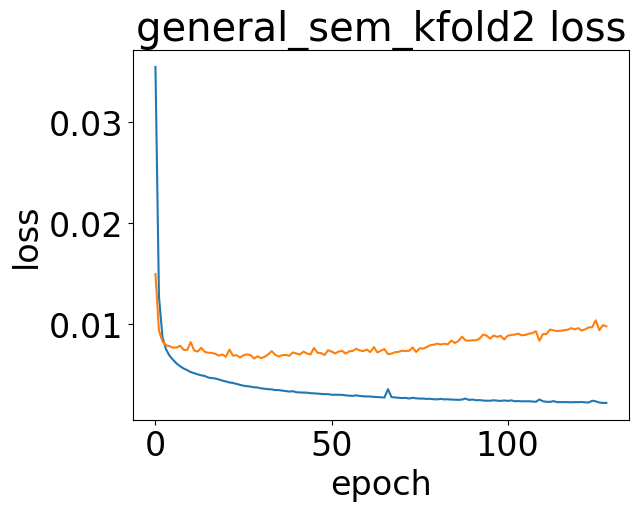

In [ ]:
# winter_model = create_model(x_train_winter, x_val_winter, y_train_winter, y_val_winter,  'winter_sem_kfold3', 350)
# spring_model = create_model(x_train_spring, x_val_spring, y_train_spring, y_val_spring, 'spring_sem_kfold', 350)
# summer_model = create_model(x_train_summer, x_val_summer, y_train_summer, y_val_summer, 'summer_sem_kfold', 350)
# autumm_model = create_model(x_train_autumm, x_val_autumm, y_train_autumm, y_val_autumm,  'autumm_sem_kfold', 350)


general_model = create_model(x_train, x_val, y_train, y_val, 'general_sem_kfold2', 350)

# Resultados das métricas

In [ ]:
#Carregando os modelos previamente treinados para avaliar o desempenho
winter_model = tf.keras.models.load_model('winter_sem_kfold2.keras')
spring_model = tf.keras.models.load_model('spring_sem_kfold.keras')
summer_model = tf.keras.models.load_model('summer_sem_kfold.keras')
autumm_model = tf.keras.models.load_model('autumm_sem_kfold.keras')
general_model = tf.keras.models.load_model('general_sem_kfold2.keras')


x_test_winter_transformed = scaler_x_winter.transform(x_test_winter)
y_test_winter_transformed = scaler_y_winter.transform(y_test_winter.values.reshape(-1, 1))

x_test_spring_transformed = scaler_x_spring.transform(x_test_spring)
y_test_spring_transformed = scaler_y_spring.transform(y_test_spring.values.reshape(-1, 1))

x_test_summer_transformed = scaler_x_summer.transform(x_test_summer)
y_test_summer_transformed = scaler_y_summer.transform(y_test_summer.values.reshape(-1, 1))

x_test_autumm_transformed = scaler_x_autumm.transform(x_test_autumm)
y_test_autumm_transformed = scaler_y_autumm.transform(y_test_autumm.values.reshape(-1, 1))

x_test_general_transformed = scaler_x.transform(x_test)
y_test_general_transformed = scaler_y.transform(y_test.values.reshape(-1, 1))


X_aux_winter, y_aux_winter = windownize(timesteps, y_timesteps, x_test_winter_transformed, y_test_winter_transformed)
X_aux_spring, y_aux_spring = windownize(timesteps, y_timesteps, x_test_spring_transformed, y_test_spring_transformed)
X_aux_summer, y_aux_summer = windownize(timesteps, y_timesteps, x_test_summer_transformed, y_test_summer_transformed)
X_aux_autumm, y_aux_autumm = windownize(timesteps, y_timesteps, x_test_autumm_transformed, y_test_autumm_transformed)
X_aux_general, y_aux_general = windownize(timesteps, y_timesteps, x_test_general_transformed, y_test_general_transformed)



y_pred_winter = winter_model.predict(X_aux_winter)
y_pred_spring = spring_model.predict(X_aux_spring)
y_pred_summer = summer_model.predict(X_aux_summer)
y_pred_autumm = autumm_model.predict(X_aux_autumm)
y_pred_general = general_model.predict(X_aux_general)



1247/1247 ━━━━━━━━━━━━━━━━━━━━ 11s 8ms/step
1463/1463 ━━━━━━━━━━━━━━━━━━━━ 12s 8ms/step
1104/1104 ━━━━━━━━━━━━━━━━━━━━ 9s 8ms/step
1104/1104 ━━━━━━━━━━━━━━━━━━━━ 10s 9ms/step
4950/4950 ━━━━━━━━━━━━━━━━━━━━ 43s 9ms/step


In [ ]:
#pre-processamento
y_real_winter = y_aux_winter.reshape(-1, 60)
y_real_spring = y_aux_spring.reshape(-1, 60)
y_real_summer = y_aux_summer.reshape(-1, 60)
y_real_autumm = y_aux_autumm.reshape(-1, 60)
y_real_general = y_aux_general.reshape(-1, 60)

y_pred_winter_unscaled = scaler_y_winter.inverse_transform(y_pred_winter[0:-1])
y_aux_winter_unscaled = scaler_y_winter.inverse_transform(y_real_winter[0:-1])

y_pred_spring_unscaled = scaler_y_spring.inverse_transform(y_pred_spring[0:-1])
y_aux_spring_unscaled = scaler_y_spring.inverse_transform(y_real_spring[0:-1])

y_pred_summer_unscaled = scaler_y_summer.inverse_transform(y_pred_summer[0:-1])
y_aux_summer_unscaled = scaler_y_summer.inverse_transform(y_real_summer[0:-1])

y_pred_autumm_unscaled = scaler_y_autumm.inverse_transform(y_pred_autumm[0:-1])
y_aux_autumm_unscaled = scaler_y_autumm.inverse_transform(y_real_autumm[0:-1])

y_pred_general_unscaled = scaler_y.inverse_transform(y_pred_general[0:-1])
y_aux_general_unscaled = scaler_y.inverse_transform(y_real_general[0:-1])


## RMSE

In [187]:
from sklearn.metrics import root_mean_squared_error

winter_rmse = root_mean_squared_error(y_pred_winter_unscaled, y_aux_winter_unscaled)
spring_rmse = root_mean_squared_error(y_pred_spring_unscaled, y_aux_spring_unscaled)
summer_rmse = root_mean_squared_error(y_pred_summer_unscaled, y_aux_summer_unscaled)
autumm_rmse = root_mean_squared_error(y_pred_autumm_unscaled, y_aux_autumm_unscaled)
general_rmse = root_mean_squared_error(y_pred_general_unscaled, y_aux_general_unscaled)

print('root_mean_squared_error para o inverno ->', winter_rmse)
print('root_mean_squared_error para a primavera ->', spring_rmse)
print('root_mean_squared_error para o verão ->', summer_rmse)
print('root_mean_squared_error para o outono ->', autumm_rmse)
print('root_mean_squared_error para o geral ->', general_rmse)



root_mean_squared_error para o inverno -> 28.748821953355787
root_mean_squared_error para a primavera -> 20.32987293739723
root_mean_squared_error para o verão -> 16.133536821787075
root_mean_squared_error para o outono -> 27.96093571408909
root_mean_squared_error para o geral -> 21.746031281717716


## R2

In [188]:
from sklearn.metrics import r2_score

winter_r2 = r2_score(y_pred_winter_unscaled, y_aux_winter_unscaled)
spring_r2 = r2_score(y_pred_spring_unscaled, y_aux_spring_unscaled)
summer_r2 = r2_score(y_pred_summer_unscaled, y_aux_summer_unscaled)
autumm_r2 = r2_score(y_pred_autumm_unscaled, y_aux_autumm_unscaled)
general_r2 = r2_score(y_pred_general_unscaled, y_aux_general_unscaled)

print('r2_score para o inverno ->', winter_r2)
print('r2_score para a primavera ->', spring_r2)
print('r2_score para o verão ->', summer_r2)
print('r2_score para o outono ->', autumm_r2)
print('r2_score para o geral ->', general_r2)

r2_score para o inverno -> 0.8295609720197119
r2_score para a primavera -> 0.926939237205212
r2_score para o verão -> 0.9389514213196573
r2_score para o outono -> 0.7738693795806441
r2_score para o geral -> 0.899729304852994


## MAE

In [189]:
#mae

from sklearn.metrics import mean_absolute_error

winter_mae = mean_absolute_error(y_pred_winter_unscaled, y_aux_winter_unscaled)
spring_mae = mean_absolute_error(y_pred_spring_unscaled, y_aux_spring_unscaled)
summer_mae = mean_absolute_error(y_pred_summer_unscaled, y_aux_summer_unscaled)
autumm_mae = mean_absolute_error(y_pred_autumm_unscaled, y_aux_autumm_unscaled)
general_mae = mean_absolute_error(y_pred_general_unscaled, y_aux_general_unscaled)

print('mean_absolute_error para o inverno ->', winter_mae)
print('mean_absolute_error para a primavera ->', spring_mae)
print('mean_absolute_error para o verão ->', summer_mae)
print('mean_absolute_error para o outono ->', autumm_mae)
print('mean_absolute_error para o geral ->', general_mae)


mean_absolute_error para o inverno -> 14.775158919141813
mean_absolute_error para a primavera -> 11.146794710901352
mean_absolute_error para o verão -> 9.057068766345754
mean_absolute_error para o outono -> 16.022556732446084
mean_absolute_error para o geral -> 10.389021934809707


## Métricas por timestep

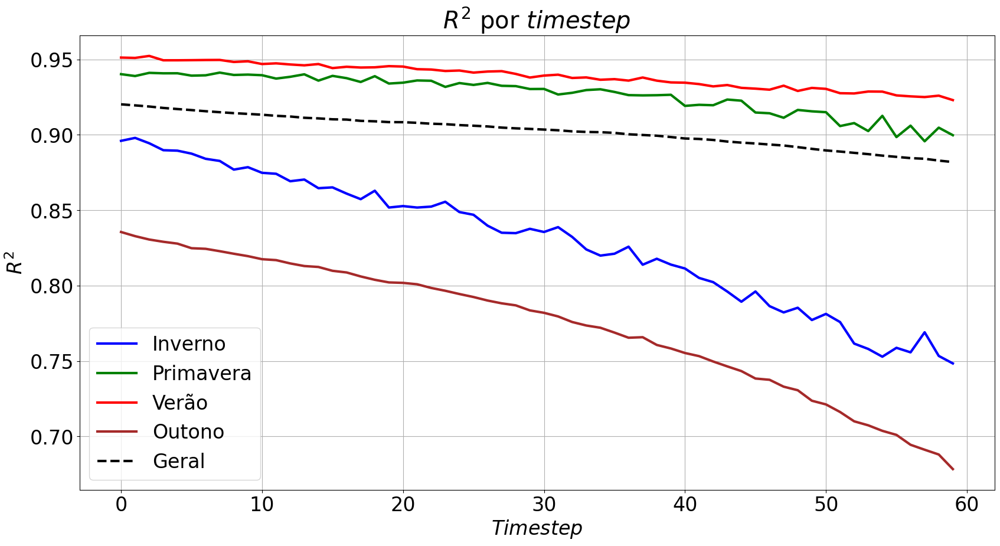

In [ ]:
#r2 by timestep
r2_winter = []
r2_spring = []
r2_summer = []
r2_autumm = []
r2_general = []

for i in range(y_pred_winter_unscaled.shape[1]):
    r2_winter.append(r2_score(y_pred_winter_unscaled[:,i], y_aux_winter_unscaled[:,i]))
    r2_spring.append(r2_score(y_pred_spring_unscaled[:,i], y_aux_spring_unscaled[:,i]))
    r2_summer.append(r2_score(y_pred_summer_unscaled[:,i], y_aux_summer_unscaled[:,i]))
    r2_autumm.append(r2_score(y_pred_autumm_unscaled[:,i], y_aux_autumm_unscaled[:,i]))
    r2_general.append(r2_score(y_pred_general_unscaled[:,i], y_aux_general_unscaled[:,i]))


plt.figure(figsize=(20, 10))
plt.plot(r2_winter, label='Inverno', linewidth=3, c='b')
plt.plot(r2_spring, label='Primavera', linewidth=3, c='g')
plt.plot(r2_summer, label='Verão', linewidth=3, c='r')
plt.plot(r2_autumm, label='Outono', linewidth=3, c='brown')
plt.plot(r2_general, label='Geral', ls='--', linewidth=3, c='black')

plt.rcParams.update({'font.size': 24})
plt.legend()

plt.title('$R^2$ por $\it{timestep}$')

plt.xlabel('$\it{Timestep}$')

plt.ylabel('$R^2$')
plt.grid()


plt.show()

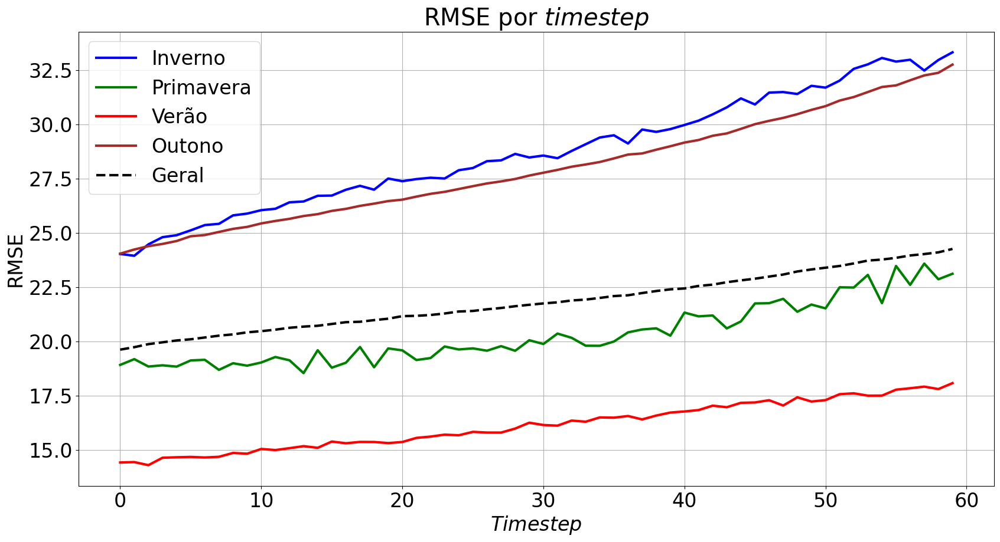

In [ ]:
#r2 by timestep
rmse_winter = []
rmse_spring = []
rmse_summer = []
rmse_autumm = []
rmse_general = []

for i in range(y_pred_winter_unscaled.shape[1]):
    rmse_winter.append(root_mean_squared_error(y_pred_winter_unscaled[:,i], y_aux_winter_unscaled[:,i]))
    rmse_spring.append(root_mean_squared_error(y_pred_spring_unscaled[:,i], y_aux_spring_unscaled[:,i]))
    rmse_summer.append(root_mean_squared_error(y_pred_summer_unscaled[:,i], y_aux_summer_unscaled[:,i]))
    rmse_autumm.append(root_mean_squared_error(y_pred_autumm_unscaled[:,i], y_aux_autumm_unscaled[:,i]))
    rmse_general.append(root_mean_squared_error(y_pred_general_unscaled[:,i], y_aux_general_unscaled[:,i]))


plt.figure(figsize=(20, 10))
plt.plot(rmse_winter, label='Inverno', linewidth=3, c='b')
plt.plot(rmse_spring, label='Primavera', linewidth=3, c='g')
plt.plot(rmse_summer, label='Verão', linewidth=3, c='r')
plt.plot(rmse_autumm, label='Outono', linewidth=3, c='brown')
plt.plot(rmse_general, label='Geral', ls='--', linewidth=3, c='black')

plt.legend()

plt.title('RMSE por $\it{timestep}$')

plt.xlabel('$\it{Timestep}$')

plt.ylabel('RMSE')
plt.grid()

plt.show()

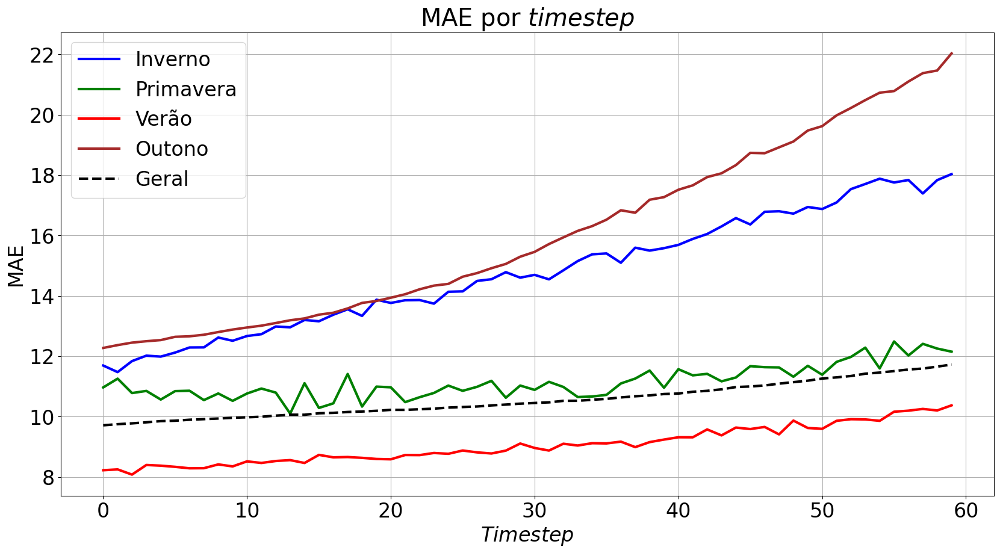

In [ ]:
#r2 by timestep
mae_winter = []
mae_spring = []
mae_summer = []
mae_autumm = []
mae_general = []

for i in range(y_pred_winter_unscaled.shape[1]):
    mae_winter.append(mean_absolute_error(y_pred_winter_unscaled[:,i], y_aux_winter_unscaled[:,i]))
    mae_spring.append(mean_absolute_error(y_pred_spring_unscaled[:,i], y_aux_spring_unscaled[:,i]))
    mae_summer.append(mean_absolute_error(y_pred_summer_unscaled[:,i], y_aux_summer_unscaled[:,i]))
    mae_autumm.append(mean_absolute_error(y_pred_autumm_unscaled[:,i], y_aux_autumm_unscaled[:,i]))
    mae_general.append(mean_absolute_error(y_pred_general_unscaled[:,i], y_aux_general_unscaled[:,i]))


plt.figure(figsize=(20, 10))
plt.plot(mae_winter, label='Inverno', linewidth=3, c='b')
plt.plot(mae_spring, label='Primavera', linewidth=3, c='g')
plt.plot(mae_summer, label='Verão', linewidth=3, c='r')
plt.plot(mae_autumm, label='Outono', linewidth=3, c='brown')
plt.plot(mae_general, label='Geral', ls='--', linewidth=3, c='black')

plt.legend()
plt.title('MAE por $\it{timestep}$')

plt.xlabel('$\it{Timestep}$')


plt.ylabel('MAE')
plt.grid()

plt.show()

## Previsões do 60º timestep para cada modelo

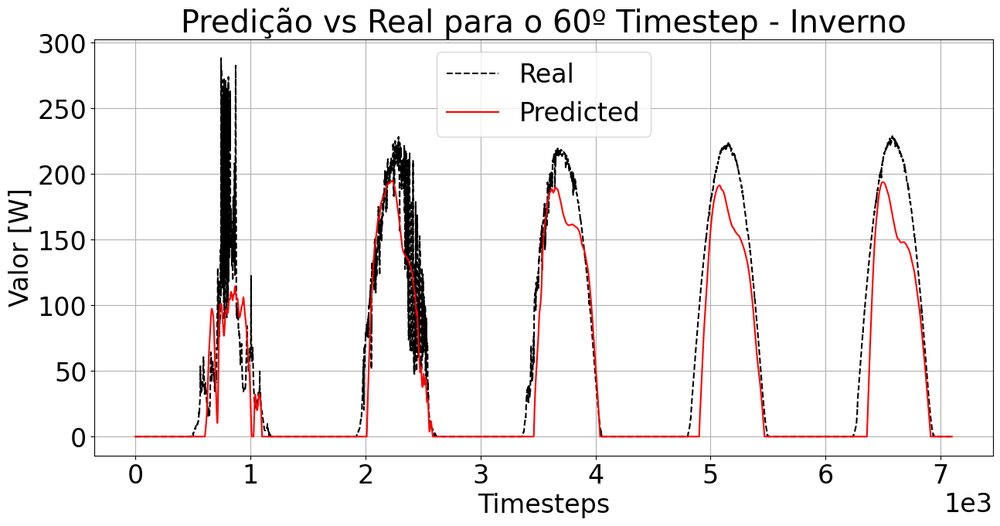

In [156]:
real = []
pred = []

predicted_timestep = 59
max_range = 300*27
for i in range(1000, max_range):
    y_sample = y_aux_winter[i][predicted_timestep][0]  # Shape: (60,1)
    y_sample_pred = y_pred_winter[i][predicted_timestep]  # Shape: (60,)

    y_sample = scaler_y_winter.inverse_transform(y_sample.reshape(1, -1))
    y_sample_pred = scaler_y_winter.inverse_transform(y_sample_pred.reshape(1, -1))

    real.append(y_sample)
    pred.append(y_sample_pred)

real = np.array(real[0:-1]).flatten()
pred = np.array(pred[0:-1]).flatten()

plt.figure(figsize=(15, 7))
plt.ticklabel_format(style='sci',scilimits=(0,0), axis='x')

plt.plot(range(0, max_range - 1000 - 1), real, label='Real', linestyle='--', color='black')
plt.plot(range(0, max_range - 1000 - 1), pred, label='Predicted', linestyle='-', color='red')
plt.xlabel('Timesteps')
plt.ylabel('Valor [W]')
plt.title('Predição vs Real para o 60º Timestep - Inverno')
plt.legend()
plt.grid(True)
plt.show()


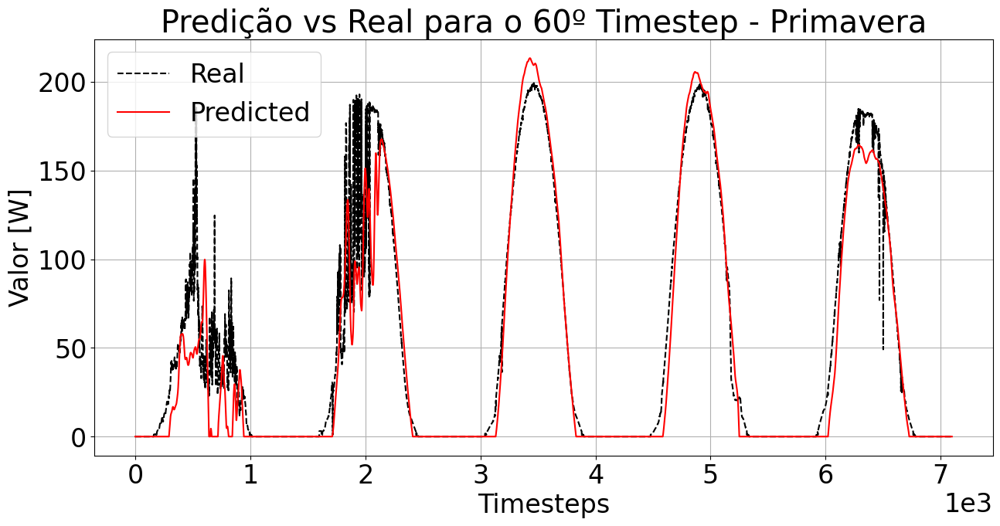

In [157]:
real = []
pred = []

predicted_timestep = 59
max_range = 300*27
for i in range(1000, max_range):
    y_sample = y_aux_spring[i][predicted_timestep][0]  # Shape: (60,1)
    y_sample_pred = y_pred_spring[i][predicted_timestep]  # Shape: (60,)

    y_sample = scaler_y_spring.inverse_transform(y_sample.reshape(1, -1))
    y_sample_pred = scaler_y_spring.inverse_transform(y_sample_pred.reshape(1, -1))

    real.append(y_sample)
    pred.append(y_sample_pred)

real = np.array(real[0:-1]).flatten()
pred = np.array(pred[0:-1]).flatten()

plt.figure(figsize=(15, 7))
plt.ticklabel_format(style='sci',scilimits=(0,0), axis='x')

plt.plot(range(0, max_range - 1000 - 1), real, label='Real', linestyle='--', color='black')
plt.plot(range(0, max_range - 1000 - 1), pred, label='Predicted', linestyle='-', color='red')
plt.xlabel('Timesteps')
plt.ylabel('Valor [W]')
plt.title('Predição vs Real para o 60º Timestep - Primavera')
plt.legend()
plt.grid(True)
plt.show()


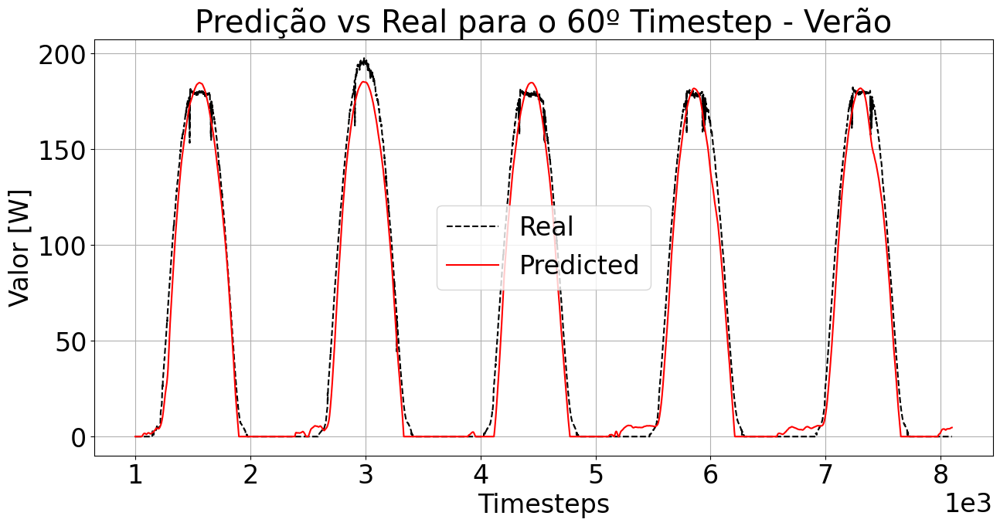

In [158]:
real = []
pred = []

predicted_timestep = 59
max_range = 300*27
for i in range(1000, max_range):
    y_sample = y_aux_summer[i][predicted_timestep][0]  # Shape: (60,1)
    y_sample_pred = y_pred_summer[i][predicted_timestep]  # Shape: (60,)

    y_sample = scaler_y_summer.inverse_transform(y_sample.reshape(1, -1))
    y_sample_pred = scaler_y_summer.inverse_transform(y_sample_pred.reshape(1, -1))

    real.append(y_sample)
    pred.append(y_sample_pred)

real = np.array(real[0:-1]).flatten()
pred = np.array(pred[0:-1]).flatten()

plt.figure(figsize=(15, 7))
plt.ticklabel_format(style='sci',scilimits=(0,0), axis='x')

plt.plot(range(1000, max_range - 1), real, label='Real', linestyle='--', color='black')
plt.plot(range(1000, max_range - 1), pred, label='Predicted', linestyle='-', color='red')
plt.xlabel('Timesteps')
plt.ylabel('Valor [W]')
plt.title('Predição vs Real para o 60º Timestep - Verão')
plt.legend()
plt.grid(True)
plt.show()


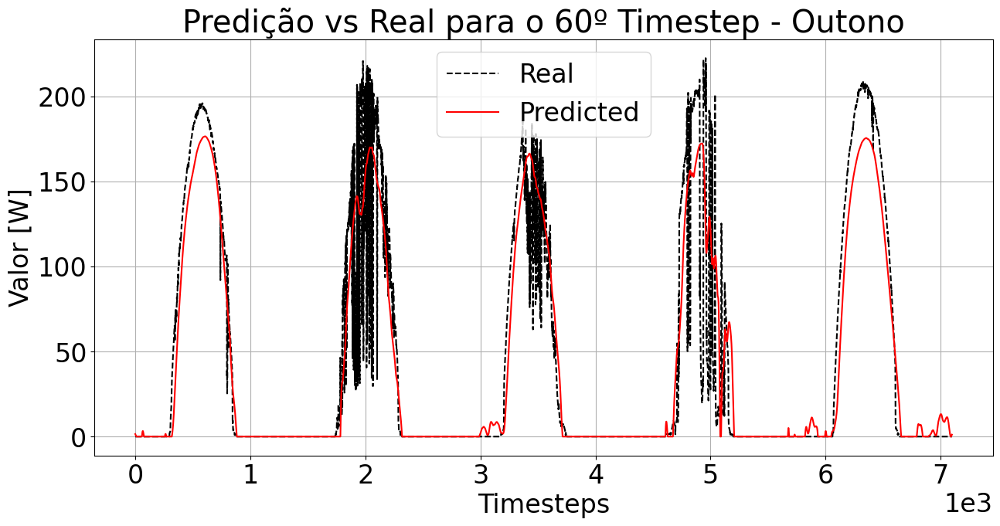

In [ ]:
real = []
pred = []

predicted_timestep = 59
max_range = 300*27
for i in range(1000, max_range):
    y_sample = y_aux_autumm[i][predicted_timestep][0]  # Shape: (60,1)
    y_sample_pred = y_pred_autumm[i][predicted_timestep]  # Shape: (60,)

    y_sample = scaler_y_autumm.inverse_transform(y_sample.reshape(1, -1))
    y_sample_pred = scaler_y_autumm.inverse_transform(y_sample_pred.reshape(1, -1))

    real.append(y_sample)
    pred.append(y_sample_pred)

real = np.array(real[0:-1]).flatten()
pred = np.array(pred[0:-1]).flatten()

plt.figure(figsize=(15, 7))
plt.ticklabel_format(style='sci',scilimits=(0,0), axis='x')
plt.plot(range(0, max_range - 1000 - 1), real, label='Real', linestyle='--', color='black')
plt.plot(range(0, max_range - 1000 - 1), pred, label='Predicted', linestyle='-', color='red')
plt.xlabel('Timesteps')
plt.ylabel('Valor [W]')
plt.title('Predição vs Real para o 60º Timestep - Outono')
plt.legend()
plt.grid(True)
plt.show()


### Previsão para o modelo geral

In [190]:
general_model2 = tf.keras.models.load_model('general_sem_kfold2.keras')

real_winter = []
pred_winter = []
real_autumm = []
pred_autumm = []
real_spring = []
pred_spring = []
real_summer = []
pred_summer = []

X_aux_general_winter, y_aux_general_winter = windownize(timesteps, y_timesteps, x_test_winter_transformed, y_test_winter_transformed)
y_pred_general = general_model.predict(X_aux_general_winter)

predicted_timestep = 59
max_range = 300*27
for i in range(1000, max_range):
    y_sample = y_aux_general_winter[i][predicted_timestep][0]  # Shape: (60,1)
    y_sample_pred = y_pred_general[i][predicted_timestep]  # Shape: (60,)

    y_sample = scaler_y.inverse_transform(y_sample.reshape(1, -1))
    y_sample_pred = scaler_y.inverse_transform(y_sample_pred.reshape(1, -1))

    real_winter.append(y_sample)
    pred_winter.append(y_sample_pred)

real_winter = np.array(real_winter[0:-1]).flatten()
pred_winter = np.array(pred_winter[0:-1]).flatten()

x_aux_general_spring, y_aux_general_spring = windownize(timesteps, y_timesteps, x_test_spring_transformed, y_test_spring_transformed)
y_pred_general = general_model2.predict(x_aux_general_spring)

predicted_timestep = 59
max_range = 300*27
for i in range(1000, max_range):
    y_sample = y_aux_general_spring[i][predicted_timestep][0]  # Shape: (60,1)
    y_sample_pred = y_pred_general[i][predicted_timestep]  # Shape: (60,)

    y_sample = scaler_y.inverse_transform(y_sample.reshape(1, -1))
    y_sample_pred = scaler_y.inverse_transform(y_sample_pred.reshape(1, -1))

    real_spring.append(y_sample)
    pred_spring.append(y_sample_pred)

real_spring = np.array(real_spring[0:-1]).flatten()
pred_spring = np.array(pred_spring[0:-1]).flatten()

x_aux_general_summer, y_aux_general_summer = windownize(timesteps, y_timesteps, x_test_summer_transformed, y_test_summer_transformed)
y_pred_general = general_model2.predict(x_aux_general_summer)

predicted_timestep = 59
max_range = 300*27

for i in range(1000, max_range):
    y_sample = y_aux_general_summer[i][predicted_timestep][0]  # Shape: (60,1)
    y_sample_pred = y_pred_general[i][predicted_timestep]  # Shape: (60,)

    y_sample = scaler_y.inverse_transform(y_sample.reshape(1, -1))
    y_sample_pred = scaler_y.inverse_transform(y_sample_pred.reshape(1, -1))

    real_summer.append(y_sample)
    pred_summer.append(y_sample_pred)

real_summer = np.array(real_summer[0:-1]).flatten()
pred_summer = np.array(pred_summer[0:-1]).flatten()

x_aux_general_autumm, y_aux_general_autumm = windownize(timesteps, y_timesteps, x_test_autumm_transformed, y_test_autumm_transformed)
y_pred_general = general_model2.predict(x_aux_general_autumm)


predicted_timestep = 59
max_range = 300*27

for i in range(1000, max_range):
    y_sample = y_aux_general_autumm[i][predicted_timestep][0]  # Shape: (60,1)
    y_sample_pred = y_pred_general[i][predicted_timestep]  # Shape: (60,)

    y_sample = scaler_y.inverse_transform(y_sample.reshape(1, -1))
    y_sample_pred = scaler_y.inverse_transform(y_sample_pred.reshape(1, -1))

    real_autumm.append(y_sample)
    pred_autumm.append(y_sample_pred)

real_autumm = np.array(real_autumm[0:-1]).flatten()
pred_autumm = np.array(pred_autumm[0:-1]).flatten()


1247/1247 ━━━━━━━━━━━━━━━━━━━━ 11s 9ms/step
1463/1463 ━━━━━━━━━━━━━━━━━━━━ 13s 9ms/step
1104/1104 ━━━━━━━━━━━━━━━━━━━━ 10s 9ms/step
1104/1104 ━━━━━━━━━━━━━━━━━━━━ 10s 9ms/step


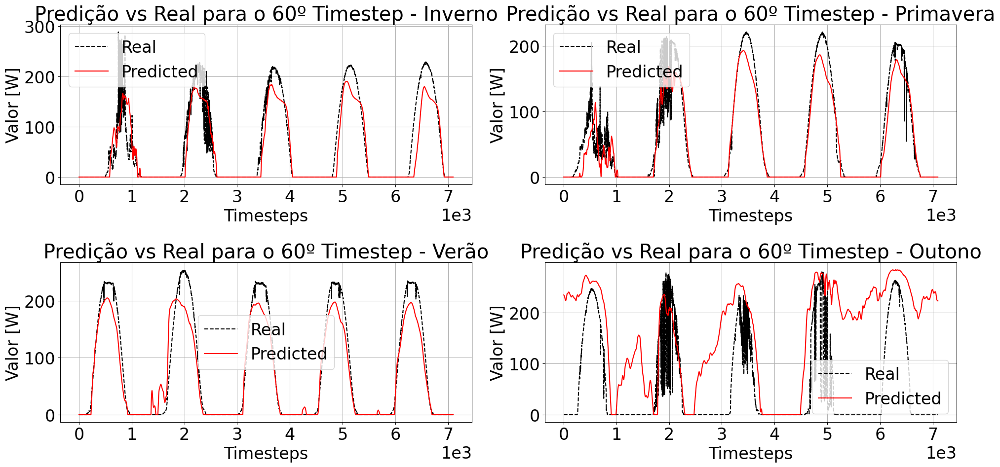

In [191]:
plt.figure(figsize=(20, 10))

plt.subplot(2, 2, 1)

plt.plot(range(0, max_range - 1000 - 1), real_winter, label='Real', linestyle='--', color='black')
plt.plot(range(0, max_range - 1000 - 1), pred_winter, label='Predicted', linestyle='-', color='red')
plt.xlabel('Timesteps')
plt.ylabel('Valor [W]')
plt.title('Predição vs Real para o 60º Timestep - Inverno')
plt.legend()
plt.grid()
plt.ticklabel_format(style='sci',scilimits=(0,0), axis='x')

plt.subplot(2, 2, 2)

plt.plot(range(0, max_range - 1000 - 1), real_spring, label='Real', linestyle='--', color='black')
plt.plot(range(0, max_range - 1000 - 1), pred_spring, label='Predicted', linestyle='-', color='red')
plt.xlabel('Timesteps')
plt.ylabel('Valor [W]')
plt.title('Predição vs Real para o 60º Timestep - Primavera')
plt.legend()
plt.grid()
plt.ticklabel_format(style='sci',scilimits=(0,0), axis='x')

plt.subplot(2, 2, 3)

plt.plot(range(0, max_range - 1000 - 1), real_summer, label='Real', linestyle='--', color='black')
plt.plot(range(0, max_range - 1000 - 1), pred_summer, label='Predicted', linestyle='-', color='red')
plt.xlabel('Timesteps')
plt.ylabel('Valor [W]')
plt.title('Predição vs Real para o 60º Timestep - Verão')
plt.legend()
plt.grid()
plt.ticklabel_format(style='sci',scilimits=(0,0), axis='x')

plt.subplot(2, 2, 4)

plt.plot(range(0, max_range - 1000 - 1), real_autumm, label='Real', linestyle='--', color='black')
plt.plot(range(0, max_range - 1000 - 1), pred_autumm, label='Predicted', linestyle='-', color='red')
plt.xlabel('Timesteps')
plt.ylabel('Valor [W]')
plt.title('Predição vs Real para o 60º Timestep - Outono')
plt.legend()
plt.grid()

plt.tight_layout()
plt.ticklabel_format(style='sci',scilimits=(0,0), axis='x')

plt.show()

# Verificação do impacto do tamanho do dataset

In [ ]:
from sklearn.metrics import root_mean_squared_error, r2_score, mean_absolute_error

def test_reduced_model(model, x_text, y_test, scaler_x, scaler_y):

    x_test_transformed = scaler_x.transform(x_text)
    y_test_transformed = scaler_y.transform(y_test.values.reshape(-1, 1))

    X_aux, y_aux = windownize(timesteps, y_timesteps, x_test_transformed, y_test_transformed)

    y_pred = model.predict(X_aux)

    y_real = y_aux.reshape(-1, 60)

    y_pred_unscaled = scaler_y.inverse_transform(y_pred[0:-1])
    y_aux_unscaled = scaler_y.inverse_transform(y_real[0:-1])

    rmse = root_mean_squared_error(y_pred_unscaled, y_aux_unscaled)
    r2 = r2_score(y_pred_unscaled, y_aux_unscaled)
    mae = mean_absolute_error(y_pred_unscaled, y_aux_unscaled)

    return rmse, r2, mae


Epoch 1/50
618/618 ━━━━━━━━━━━━━━━━━━━━ 31s 48ms/step - loss: 0.0545 - val_loss: 0.0110
Epoch 2/50
618/618 ━━━━━━━━━━━━━━━━━━━━ 26s 43ms/step - loss: 0.0121 - val_loss: 0.0095
Epoch 3/50
618/618 ━━━━━━━━━━━━━━━━━━━━ 28s 46ms/step - loss: 0.0089 - val_loss: 0.0080
Epoch 4/50
618/618 ━━━━━━━━━━━━━━━━━━━━ 26s 42ms/step - loss: 0.0079 - val_loss: 0.0079
Epoch 5/50
618/618 ━━━━━━━━━━━━━━━━━━━━ 26s 42ms/step - loss: 0.0072 - val_loss: 0.0077
Epoch 6/50
618/618 ━━━━━━━━━━━━━━━━━━━━ 26s 42ms/step - loss: 0.0066 - val_loss: 0.0076
Epoch 7/50
618/618 ━━━━━━━━━━━━━━━━━━━━ 26s 42ms/step - loss: 0.0063 - val_loss: 0.0078
Epoch 8/50
618/618 ━━━━━━━━━━━━━━━━━━━━ 29s 46ms/step - loss: 0.0060 - val_loss: 0.0082
Epoch 9/50
618/618 ━━━━━━━━━━━━━━━━━━━━ 26s 43ms/step - loss: 0.0060 - val_loss: 0.0077
Epoch 10/50
618/618 ━━━━━━━━━━━━━━━━━━━━ 26s 42ms/step - loss: 0.0056 - val_loss: 0.0076
Epoch 11/50
618/618 ━━━━━━━━━━━━━━━━━━━━ 27s 43ms/step - loss: 0.0053 - val_loss: 0.0080
Epoch 12/50
618/618 ━━━━━━━━━━

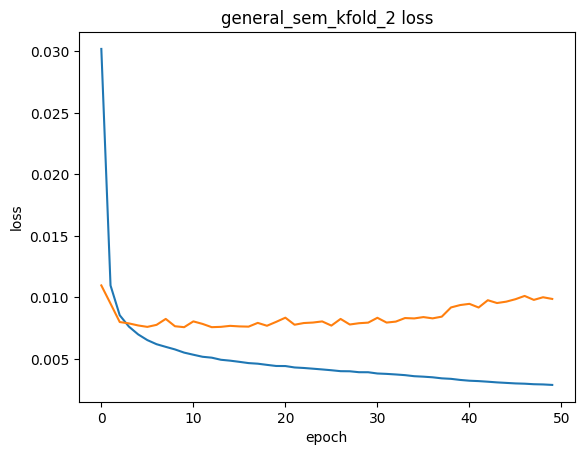

4950/4950 ━━━━━━━━━━━━━━━━━━━━ 38s 8ms/step
Epoch 1/50
618/618 ━━━━━━━━━━━━━━━━━━━━ 29s 45ms/step - loss: 0.0598 - val_loss: 0.0143
Epoch 2/50
618/618 ━━━━━━━━━━━━━━━━━━━━ 29s 47ms/step - loss: 0.0145 - val_loss: 0.0100
Epoch 3/50
618/618 ━━━━━━━━━━━━━━━━━━━━ 29s 46ms/step - loss: 0.0104 - val_loss: 0.0084
Epoch 4/50
618/618 ━━━━━━━━━━━━━━━━━━━━ 28s 46ms/step - loss: 0.0080 - val_loss: 0.0081
Epoch 5/50
618/618 ━━━━━━━━━━━━━━━━━━━━ 26s 42ms/step - loss: 0.0070 - val_loss: 0.0079
Epoch 6/50
618/618 ━━━━━━━━━━━━━━━━━━━━ 26s 42ms/step - loss: 0.0065 - val_loss: 0.0077
Epoch 7/50
618/618 ━━━━━━━━━━━━━━━━━━━━ 28s 45ms/step - loss: 0.0061 - val_loss: 0.0075
Epoch 8/50
618/618 ━━━━━━━━━━━━━━━━━━━━ 28s 45ms/step - loss: 0.0057 - val_loss: 0.0074
Epoch 9/50
618/618 ━━━━━━━━━━━━━━━━━━━━ 27s 44ms/step - loss: 0.0055 - val_loss: 0.0073
Epoch 10/50
618/618 ━━━━━━━━━━━━━━━━━━━━ 30s 48ms/step - loss: 0.0054 - val_loss: 0.0073
Epoch 11/50
618/618 ━━━━━━━━━━━━━━━━━━━━ 29s 47ms/step - loss: 0.0051 - val

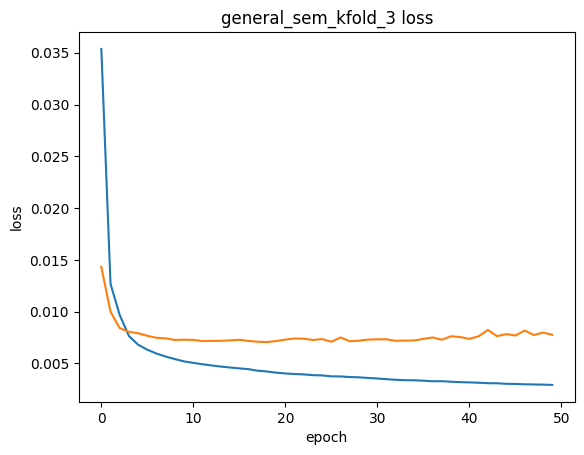

4950/4950 ━━━━━━━━━━━━━━━━━━━━ 37s 7ms/step
Epoch 1/50
618/618 ━━━━━━━━━━━━━━━━━━━━ 30s 45ms/step - loss: 0.0603 - val_loss: 0.0131
Epoch 2/50
618/618 ━━━━━━━━━━━━━━━━━━━━ 26s 41ms/step - loss: 0.0140 - val_loss: 0.0097
Epoch 3/50
618/618 ━━━━━━━━━━━━━━━━━━━━ 27s 44ms/step - loss: 0.0095 - val_loss: 0.0087
Epoch 4/50
618/618 ━━━━━━━━━━━━━━━━━━━━ 26s 41ms/step - loss: 0.0078 - val_loss: 0.0083
Epoch 5/50
618/618 ━━━━━━━━━━━━━━━━━━━━ 28s 45ms/step - loss: 0.0071 - val_loss: 0.0079
Epoch 6/50
618/618 ━━━━━━━━━━━━━━━━━━━━ 26s 41ms/step - loss: 0.0066 - val_loss: 0.0083
Epoch 7/50
618/618 ━━━━━━━━━━━━━━━━━━━━ 26s 41ms/step - loss: 0.0062 - val_loss: 0.0077
Epoch 8/50
618/618 ━━━━━━━━━━━━━━━━━━━━ 30s 49ms/step - loss: 0.0059 - val_loss: 0.0077
Epoch 9/50
618/618 ━━━━━━━━━━━━━━━━━━━━ 27s 44ms/step - loss: 0.0056 - val_loss: 0.0077
Epoch 10/50
618/618 ━━━━━━━━━━━━━━━━━━━━ 26s 41ms/step - loss: 0.0054 - val_loss: 0.0087
Epoch 11/50
618/618 ━━━━━━━━━━━━━━━━━━━━ 27s 44ms/step - loss: 0.0054 - val

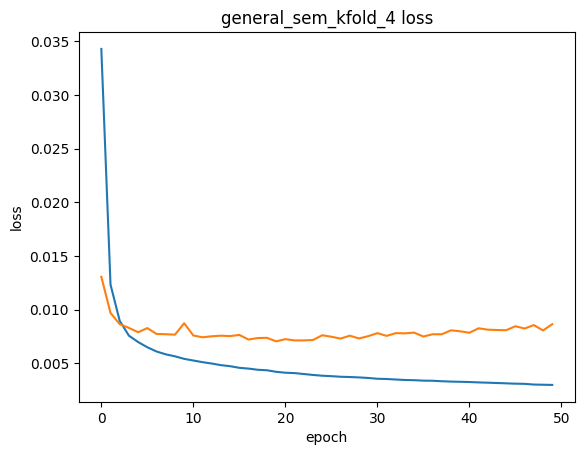

4950/4950 ━━━━━━━━━━━━━━━━━━━━ 34s 7ms/step


In [55]:
x_train_winter, x_val_winter, x_test_winter, y_train_winter, y_val_winter, y_test_winter = generate_train_test_val(winter_data)
x_train_spring, x_val_spring, x_test_spring, y_train_spring, y_val_spring, y_test_spring = generate_train_test_val(spring_data)
x_train_summer, x_val_summer, x_test_summer, y_train_summer, y_val_summer, y_test_summer = generate_train_test_val(summer_data)
x_train_autumm, x_val_autumm, x_test_autumm, y_train_autumm, y_val_autumm, y_test_autumm = generate_train_test_val(autumm_data)


x_train_reduzido = pd.concat([x_train_winter])
x_val_reduzido = pd.concat([x_val_winter, x_val_spring, x_val_summer, x_val_autumm])
x_test_reduzido = pd.concat([x_test_winter, x_test_spring, x_test_summer, x_test_autumm])

y_train_reduzido = pd.concat([y_train_winter])
y_val_reduzido = pd.concat([y_val_winter, y_val_spring, y_val_summer, y_val_autumm])
y_test_reduzido = pd.concat([y_test_winter, y_test_spring, y_test_summer, y_test_autumm])

scaler_x_reduzido_1 = MinMaxScaler()
scaler_y_reduzido_1 = MinMaxScaler()

x_train_reduzido = scaler_x_reduzido_1.fit_transform(x_train_reduzido)
x_val_reduzido = scaler_x_reduzido_1.transform(x_val_reduzido)

y_train_reduzido = scaler_y_reduzido_1.fit_transform(y_train_reduzido.values.reshape(-1, 1))
y_val_reduzido = scaler_y_reduzido_1.transform(y_val_reduzido.values.reshape(-1, 1))

general_model_1 = create_model(x_train, x_val, y_train, y_val, 'general_sem_kfold_1', 50)


rmse_1, r2_1, mae_1 = test_reduced_model(general_model_1[0], x_test_reduzido, y_test_reduzido, scaler_x_reduzido_1, scaler_y_reduzido_1)


#####

x_train_reduzido = pd.concat([x_train_winter, x_train_spring])
y_train_reduzido = pd.concat([y_train_winter, y_train_spring])
x_val_reduzido = pd.concat([x_val_winter, x_val_spring, x_val_summer, x_val_autumm])
x_test_reduzido = pd.concat([x_test_winter, x_test_spring, x_test_summer, x_test_autumm])
y_val_reduzido = pd.concat([y_val_winter, y_val_spring, y_val_summer, y_val_autumm])
y_test_reduzido = pd.concat([y_test_winter, y_test_spring, y_test_summer, y_test_autumm])

scaler_x_reduzido_2 = MinMaxScaler()
scaler_y_reduzido_2 = MinMaxScaler()

x_train_reduzido = scaler_x_reduzido_2.fit_transform(x_train_reduzido)
x_val_reduzido = scaler_x_reduzido_2.transform(x_val_reduzido)

y_train_reduzido = scaler_y_reduzido_2.fit_transform(y_train_reduzido.values.reshape(-1, 1))
y_val_reduzido = scaler_y_reduzido_2.transform(y_val_reduzido.values.reshape(-1, 1))

general_model_2 = create_model(x_train, x_val, y_train, y_val, 'general_sem_kfold_2', 50)

rmse_2, r2_2, mae_2 = test_reduced_model(general_model_2[0], x_test_reduzido, y_test_reduzido, scaler_x_reduzido_2, scaler_y_reduzido_2)

#####

x_train_reduzido = pd.concat([x_train_winter, x_train_spring, x_train_summer])
y_train_reduzido = pd.concat([y_train_winter, y_train_spring, y_train_summer])
x_val_reduzido = pd.concat([x_val_winter, x_val_spring, x_val_summer, x_val_autumm])
x_test_reduzido = pd.concat([x_test_winter, x_test_spring, x_test_summer, x_test_autumm])
y_val_reduzido = pd.concat([y_val_winter, y_val_spring, y_val_summer, y_val_autumm])
y_test_reduzido = pd.concat([y_test_winter, y_test_spring, y_test_summer, y_test_autumm])

scaler_x_reduzido_3 = MinMaxScaler()
scaler_y_reduzido_3 = MinMaxScaler()

x_train_reduzido = scaler_x_reduzido_3.fit_transform(x_train_reduzido)
x_val_reduzido = scaler_x_reduzido_3.transform(x_val_reduzido)

y_train_reduzido = scaler_y_reduzido_3.fit_transform(y_train_reduzido.values.reshape(-1, 1))
y_val_reduzido = scaler_y_reduzido_3.transform(y_val_reduzido.values.reshape(-1, 1))


general_model_3 = create_model(x_train, x_val, y_train, y_val, 'general_sem_kfold_3', 50)

rmse_3, r2_3, mae_3 = test_reduced_model(general_model_3[0], x_test_reduzido, y_test_reduzido, scaler_x_reduzido_3, scaler_y_reduzido_3)

#####

x_train_reduzido = pd.concat([x_train_winter, x_train_spring, x_train_summer, x_train_autumm])
y_train_reduzido = pd.concat([y_train_winter, y_train_spring, y_train_summer, y_train_autumm])
x_val_reduzido = pd.concat([x_val_winter, x_val_spring, x_val_summer, x_val_autumm])
x_test_reduzido = pd.concat([x_test_winter, x_test_spring, x_test_summer, x_test_autumm])
y_val_reduzido = pd.concat([y_val_winter, y_val_spring, y_val_summer, y_val_autumm])
y_test_reduzido = pd.concat([y_test_winter, y_test_spring, y_test_summer, y_test_autumm])

scaler_x_reduzido_4 = MinMaxScaler()
scaler_y_reduzido_4 = MinMaxScaler()

x_train_reduzido = scaler_x_reduzido_4.fit_transform(x_train_reduzido)
x_val_reduzido = scaler_x_reduzido_4.transform(x_val_reduzido)

y_train_reduzido = scaler_y_reduzido_4.fit_transform(y_train_reduzido.values.reshape(-1, 1))
y_val_reduzido = scaler_y_reduzido_4.transform(y_val_reduzido.values.reshape(-1, 1))

general_model_4 = create_model(x_train, x_val, y_train, y_val, 'general_sem_kfold_4', 50)

rmse_4, r2_4, mae_4 = test_reduced_model(general_model_4[0], x_test_reduzido, y_test_reduzido, scaler_x_reduzido_4, scaler_y_reduzido_4)


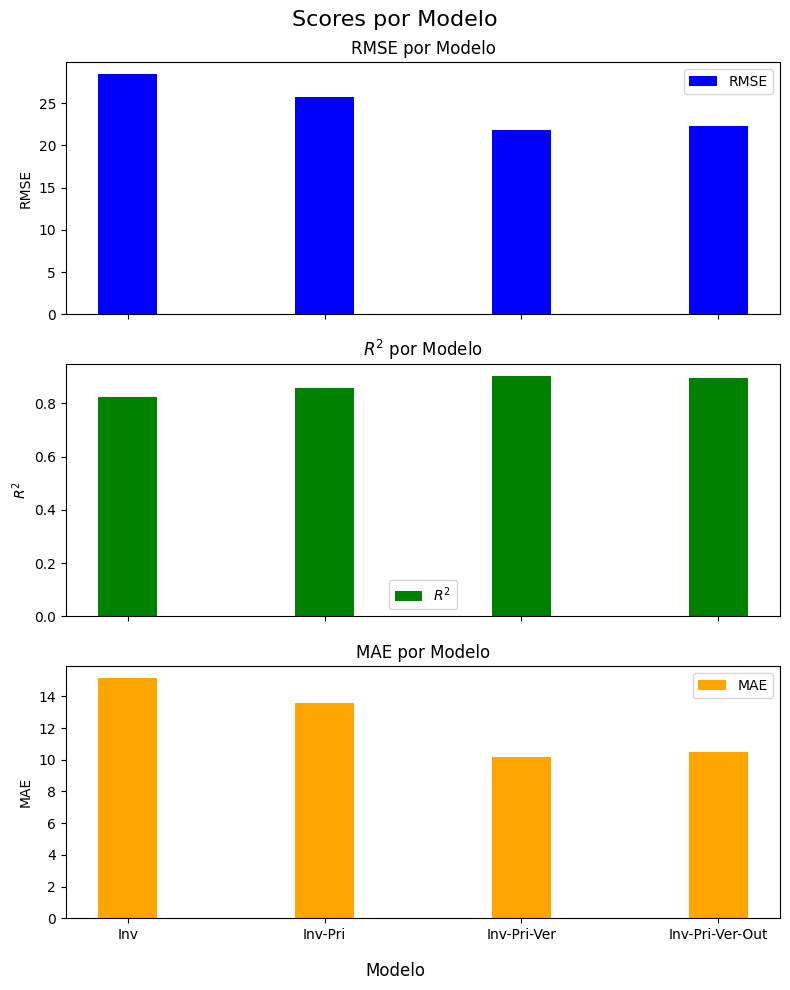

In [65]:
#plot a bar chart for each metric with subplot

rmse = [rmse_1, rmse_2, rmse_3, rmse_4]

r2 = [r2_1, r2_2, r2_3, r2_4]

mae = [mae_1, mae_2, mae_3, mae_4]

labels = ['Inv', 'Inv-Pri', 'Inv-Pri-Ver', 'Inv-Pri-Ver-Out']

x = np.arange(len(labels))
bar_width = 0.3

fig, axs = plt.subplots(3, 1, figsize=(8, 10), sharex=True)

# Plot para RMSE
axs[0].bar(x, rmse, bar_width, color='blue', label='RMSE')
axs[0].set_ylabel('RMSE')
axs[0].set_title('RMSE por Modelo')
axs[0].legend()

# Plot para R2
axs[1].bar(x, r2, bar_width, color='green', label='$R^2$')
axs[1].set_ylabel('$R^2$')
axs[1].set_title('$R^2$ por Modelo')
axs[1].legend()

# Plot para MAE
axs[2].bar(x, mae, bar_width, color='orange', label='MAE')
axs[2].set_ylabel('MAE')
axs[2].set_title('MAE por Modelo')
axs[2].set_xticks(x)
axs[2].set_xticklabels(labels)
axs[2].legend()

# Ajuste final
fig.supxlabel('Modelo')
fig.suptitle('Scores por Modelo', fontsize=16)
fig.tight_layout()
plt.show()

# Hiperparametros


Testing dropout=0.1
Epoch 1/350
155/155 ━━━━━━━━━━━━━━━━━━━━ 9s 48ms/step - loss: 0.0762 - val_loss: 0.0281
Epoch 2/350
155/155 ━━━━━━━━━━━━━━━━━━━━ 7s 44ms/step - loss: 0.0308 - val_loss: 0.0195
Epoch 3/350
155/155 ━━━━━━━━━━━━━━━━━━━━ 7s 47ms/step - loss: 0.0198 - val_loss: 0.0141
Epoch 4/350
155/155 ━━━━━━━━━━━━━━━━━━━━ 7s 45ms/step - loss: 0.0151 - val_loss: 0.0132
Epoch 5/350
155/155 ━━━━━━━━━━━━━━━━━━━━ 7s 44ms/step - loss: 0.0132 - val_loss: 0.0118
Epoch 6/350
155/155 ━━━━━━━━━━━━━━━━━━━━ 8s 48ms/step - loss: 0.0109 - val_loss: 0.0108
Epoch 7/350
155/155 ━━━━━━━━━━━━━━━━━━━━ 7s 48ms/step - loss: 0.0099 - val_loss: 0.0112
Epoch 8/350
155/155 ━━━━━━━━━━━━━━━━━━━━ 10s 64ms/step - loss: 0.0097 - val_loss: 0.0113
Epoch 9/350
155/155 ━━━━━━━━━━━━━━━━━━━━ 9s 61ms/step - loss: 0.0095 - val_loss: 0.0112
Epoch 10/350
155/155 ━━━━━━━━━━━━━━━━━━━━ 10s 67ms/step - loss: 0.0089 - val_loss: 0.0112
Epoch 11/350
155/155 ━━━━━━━━━━━━━━━━━━━━ 7s 48ms/step - loss: 0.0089 - val_loss: 0.0108
Epoch 1

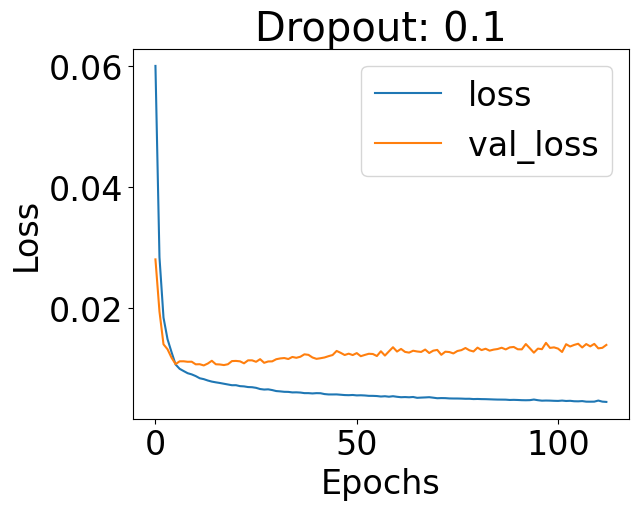


Testing dropout=0.2
Epoch 1/350
155/155 ━━━━━━━━━━━━━━━━━━━━ 10s 51ms/step - loss: 0.0734 - val_loss: 0.0260
Epoch 2/350
155/155 ━━━━━━━━━━━━━━━━━━━━ 7s 45ms/step - loss: 0.0313 - val_loss: 0.0180
Epoch 3/350
155/155 ━━━━━━━━━━━━━━━━━━━━ 7s 45ms/step - loss: 0.0218 - val_loss: 0.0144
Epoch 4/350
155/155 ━━━━━━━━━━━━━━━━━━━━ 7s 46ms/step - loss: 0.0167 - val_loss: 0.0128
Epoch 5/350
155/155 ━━━━━━━━━━━━━━━━━━━━ 7s 46ms/step - loss: 0.0146 - val_loss: 0.0127
Epoch 6/350
155/155 ━━━━━━━━━━━━━━━━━━━━ 8s 51ms/step - loss: 0.0139 - val_loss: 0.0120
Epoch 7/350
155/155 ━━━━━━━━━━━━━━━━━━━━ 8s 49ms/step - loss: 0.0119 - val_loss: 0.0115
Epoch 8/350
155/155 ━━━━━━━━━━━━━━━━━━━━ 8s 50ms/step - loss: 0.0113 - val_loss: 0.0114
Epoch 9/350
155/155 ━━━━━━━━━━━━━━━━━━━━ 7s 47ms/step - loss: 0.0111 - val_loss: 0.0114
Epoch 10/350
155/155 ━━━━━━━━━━━━━━━━━━━━ 8s 49ms/step - loss: 0.0110 - val_loss: 0.0115
Epoch 11/350
155/155 ━━━━━━━━━━━━━━━━━━━━ 8s 49ms/step - loss: 0.0103 - val_loss: 0.0114
Epoch 12

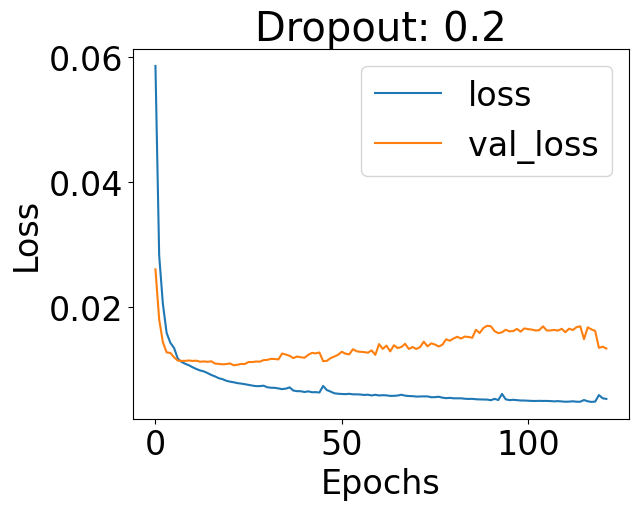


Testing dropout=0.3
Epoch 1/350
155/155 ━━━━━━━━━━━━━━━━━━━━ 10s 52ms/step - loss: 0.0756 - val_loss: 0.0265
Epoch 2/350
155/155 ━━━━━━━━━━━━━━━━━━━━ 7s 47ms/step - loss: 0.0325 - val_loss: 0.0159
Epoch 3/350
155/155 ━━━━━━━━━━━━━━━━━━━━ 8s 50ms/step - loss: 0.0207 - val_loss: 0.0145
Epoch 4/350
155/155 ━━━━━━━━━━━━━━━━━━━━ 8s 49ms/step - loss: 0.0170 - val_loss: 0.0134
Epoch 5/350
155/155 ━━━━━━━━━━━━━━━━━━━━ 7s 45ms/step - loss: 0.0146 - val_loss: 0.0136
Epoch 6/350
155/155 ━━━━━━━━━━━━━━━━━━━━ 8s 48ms/step - loss: 0.0140 - val_loss: 0.0124
Epoch 7/350
155/155 ━━━━━━━━━━━━━━━━━━━━ 7s 48ms/step - loss: 0.0129 - val_loss: 0.0128
Epoch 8/350
155/155 ━━━━━━━━━━━━━━━━━━━━ 8s 51ms/step - loss: 0.0123 - val_loss: 0.0124
Epoch 9/350
155/155 ━━━━━━━━━━━━━━━━━━━━ 8s 49ms/step - loss: 0.0114 - val_loss: 0.0120
Epoch 10/350
155/155 ━━━━━━━━━━━━━━━━━━━━ 7s 48ms/step - loss: 0.0115 - val_loss: 0.0124
Epoch 11/350
155/155 ━━━━━━━━━━━━━━━━━━━━ 7s 46ms/step - loss: 0.0114 - val_loss: 0.0127
Epoch 12

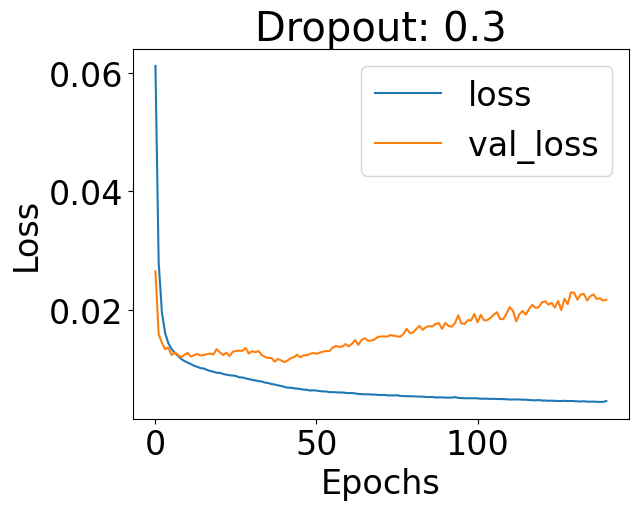


Testing dropout=0.4
Epoch 1/350
155/155 ━━━━━━━━━━━━━━━━━━━━ 11s 57ms/step - loss: 0.0772 - val_loss: 0.0278
Epoch 2/350
155/155 ━━━━━━━━━━━━━━━━━━━━ 8s 48ms/step - loss: 0.0378 - val_loss: 0.0142
Epoch 3/350
155/155 ━━━━━━━━━━━━━━━━━━━━ 8s 54ms/step - loss: 0.0236 - val_loss: 0.0119
Epoch 4/350
155/155 ━━━━━━━━━━━━━━━━━━━━ 8s 51ms/step - loss: 0.0190 - val_loss: 0.0117
Epoch 5/350
155/155 ━━━━━━━━━━━━━━━━━━━━ 7s 48ms/step - loss: 0.0168 - val_loss: 0.0118
Epoch 6/350
155/155 ━━━━━━━━━━━━━━━━━━━━ 7s 47ms/step - loss: 0.0150 - val_loss: 0.0117
Epoch 7/350
155/155 ━━━━━━━━━━━━━━━━━━━━ 7s 46ms/step - loss: 0.0141 - val_loss: 0.0118
Epoch 8/350
155/155 ━━━━━━━━━━━━━━━━━━━━ 7s 46ms/step - loss: 0.0131 - val_loss: 0.0122
Epoch 9/350
155/155 ━━━━━━━━━━━━━━━━━━━━ 7s 47ms/step - loss: 0.0124 - val_loss: 0.0132
Epoch 10/350
155/155 ━━━━━━━━━━━━━━━━━━━━ 8s 51ms/step - loss: 0.0122 - val_loss: 0.0123
Epoch 11/350
155/155 ━━━━━━━━━━━━━━━━━━━━ 7s 48ms/step - loss: 0.0116 - val_loss: 0.0128
Epoch 12

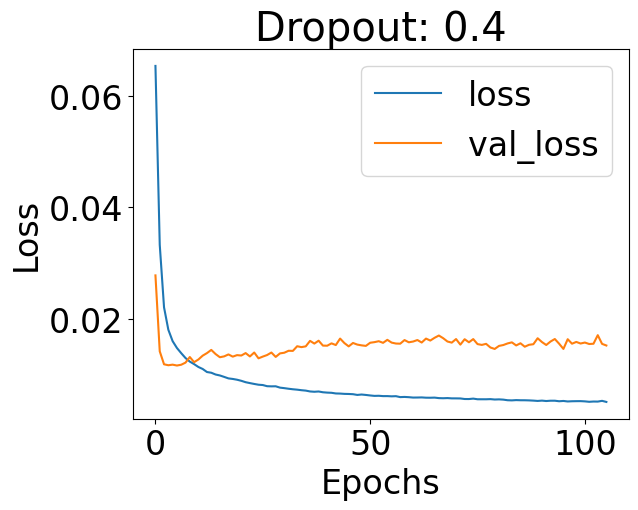


Testing dropout=0.5
Epoch 1/350
155/155 ━━━━━━━━━━━━━━━━━━━━ 10s 52ms/step - loss: 0.0769 - val_loss: 0.0239
Epoch 2/350
155/155 ━━━━━━━━━━━━━━━━━━━━ 7s 46ms/step - loss: 0.0389 - val_loss: 0.0149
Epoch 3/350
155/155 ━━━━━━━━━━━━━━━━━━━━ 7s 45ms/step - loss: 0.0254 - val_loss: 0.0122
Epoch 4/350
155/155 ━━━━━━━━━━━━━━━━━━━━ 7s 46ms/step - loss: 0.0211 - val_loss: 0.0120
Epoch 5/350
155/155 ━━━━━━━━━━━━━━━━━━━━ 7s 45ms/step - loss: 0.0184 - val_loss: 0.0121
Epoch 6/350
155/155 ━━━━━━━━━━━━━━━━━━━━ 7s 45ms/step - loss: 0.0164 - val_loss: 0.0122
Epoch 7/350
155/155 ━━━━━━━━━━━━━━━━━━━━ 7s 46ms/step - loss: 0.0154 - val_loss: 0.0119
Epoch 8/350
155/155 ━━━━━━━━━━━━━━━━━━━━ 7s 45ms/step - loss: 0.0140 - val_loss: 0.0128
Epoch 9/350
155/155 ━━━━━━━━━━━━━━━━━━━━ 7s 45ms/step - loss: 0.0137 - val_loss: 0.0120
Epoch 10/350
155/155 ━━━━━━━━━━━━━━━━━━━━ 7s 45ms/step - loss: 0.0129 - val_loss: 0.0120
Epoch 11/350
155/155 ━━━━━━━━━━━━━━━━━━━━ 7s 45ms/step - loss: 0.0125 - val_loss: 0.0120
Epoch 12

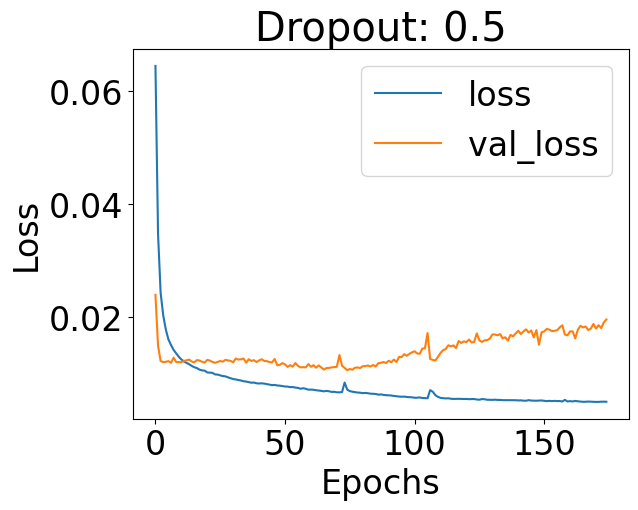

Best dropout: dropout_0.2 with val_loss: 0.01339309848845005


In [ ]:
# Lista de valores de dropout a serem testados
dropout_values = [0.1, 0.2, 0.3, 0.4, 0.5]
hs = []
# Função para realizar a busca de hiperparâmetro (apenas dropout)
def grid_search_dropout(x_data, x_val_data, y_data, y_val_data, name_prefix):
    global results
    global hs
    timesteps = 300
    y_timesteps = 60

    X_train, y_train = windownize(timesteps, y_timesteps, x_data, y_data)
    X_val, y_val = windownize(timesteps, y_timesteps, x_val_data, y_val_data)

    batch_size = 128
    epochs = 350
    patience = 100
    learning_rate = 0.0001  # Taxa de aprendizado fixa

    results = {}

    for dropout in dropout_values:
        print(f"\nTesting dropout={dropout}")

        # Define o modelo
        with tf.device("/GPU:0"):
            model = Sequential(
                [
                    Input(shape=(300, 5)),
                    LSTM(16, return_sequences=True),
                    Dropout(dropout),
                    LSTM(32, return_sequences=True),
                    Dropout(dropout),
                    LSTM(64),
                    Dropout(dropout),
                    Dense(60, activation="relu"),
                ]
            )

            model.compile(
                optimizer=tf.keras.optimizers.Adam(learning_rate=learning_rate), 
                loss="mse"
            )

        # EarlyStopping
        early_stopping = EarlyStopping(
            monitor="val_loss",
            patience=patience,
            restore_best_weights=True,
            verbose=1,
        )

        # Treinamento
        history = model.fit(
            X_train,
            y_train,
            validation_data=(X_val, y_val),
            epochs=epochs,
            batch_size=batch_size,
            verbose=1,
            callbacks=[early_stopping],
        )
        hs.append(history)

        # Salva a perda de validação final
        final_val_loss = history.history["val_loss"][-1]
        results[f"dropout_{dropout}"] = final_val_loss

        # Plot dos resultados
        plt.plot(history.history["loss"], label="loss")
        plt.plot(history.history["val_loss"], label="val_loss")
        plt.title(f"Dropout: {dropout}")
        plt.xlabel("Epochs")
        plt.ylabel("Loss")
        plt.legend()
        plt.show()

        # Salva o modelo
        model.save(f"{name_prefix}_dropout_{dropout}.keras")

# Chamada da função
grid_search_dropout(x_train_winter, x_val_winter, y_train_winter, y_val_winter, "LSTM_Model")

# Melhor valor de dropout
best_dropout = min(results, key=results.get)
print(f"Best dropout: {best_dropout} with val_loss: {results[best_dropout]}")

#salvando históricos para gerar os gráficos de analise
# obs: gráficos gerados em outro script
import pickle
with open('historys.pkl', 'wb') as f:
    pickle.dump(hs, f)

